In [90]:
import numpy as np
import torch
import cv2 
import matplotlib.pyplot as plt
import os
import csv



In [91]:
def preprocess_image(img):
    """Enhanced preprocessing that reduces noise amplification"""
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (3, 3), 0)    
    return blurred

def preprocess_template(img):
    """Template preprocessing without ximgproc dependency"""
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        gray = img

    blurred = cv2.GaussianBlur(gray, (3, 3), 0)
    return blurred



In [92]:
def strict_horizontal_merge(digit_boxes, 
                          max_x_gap=200,  # Max horizontal gap between digits
                          max_y_diff=28,  # Max vertical misalignment
                          height_ratio_thresh=0.5):  # Max height difference (50%)
    if not digit_boxes:
        return []
    
    # Sort by x-coordinate (left to right)
    boxes = sorted(digit_boxes, key=lambda b: b[0])
    
    merged = []
    current = list(boxes[0])
    
    for box in boxes[1:]:
        curr_x1, curr_y1, curr_x2, curr_y2 = current
        box_x1, box_y1, box_x2, box_y2 = box
        
        curr_height = curr_y2 - curr_y1
        box_height = box_y2 - box_y1
        
        # Conditions for Pakistani serial numbers:
        # 1. Reasonable horizontal gap (but can be large for spaced serials)
        # 2. Nearly identical vertical position (strict)
        # 3. Very similar heights
        if (abs(box_x1 - curr_x2) <= max_x_gap and
            abs(box_y1 - curr_y1) <= max_y_diff and
            abs(curr_height - box_height)/max(curr_height, box_height) <= height_ratio_thresh):
            
            # Merge horizontally
            current = [
                min(curr_x1, box_x1),
                min(curr_y1, box_y1),  # Keep original y-position
                max(curr_x2, box_x2),
                max(curr_y2, box_y2)
            ]
        else:
            merged.append(current)
            current = list(box)
    
    merged.append(current)
    
    # Final expansion for prefix letters
    result = []
    for box in merged:
        x1, y1, x2, y2 = box
        result.append((
            max(0, x1 - 70),  # Expand left for prefix
            y1,
            x2,
            y2
        ))
    
    return result


In [93]:
def merge_overlapping_boxes(boxes, overlap_threshold=0.1):
    """Merge only boxes that overlap significantly (for same serial number)"""
    if len(boxes) < 2:
        return boxes
    
    # Convert to [x1,y1,x2,y2] and calculate areas
    boxes = np.array(boxes)
    areas = (boxes[:,2] - boxes[:,0] + 1) * (boxes[:,3] - boxes[:,1] + 1)
    
    merged = []
    used = set()
    
    for i in range(len(boxes)):
        if i in used:
            continue
            
        current = boxes[i]
        to_merge = [current]
        
        for j in range(i+1, len(boxes)):
            if j in used:
                continue
                
            # Calculate overlap area
            x1 = max(current[0], boxes[j][0])
            y1 = max(current[1], boxes[j][1])
            x2 = min(current[2], boxes[j][2])
            y2 = min(current[3], boxes[j][3])
            
            overlap_area = max(0, x2 - x1 + 1) * max(0, y2 - y1 + 1)
            min_area = min(areas[i], areas[j])
            
            if overlap_area / min_area > overlap_threshold:
                to_merge.append(boxes[j])
                used.add(j)
        
        # Create merged box
        x1 = min(box[0] for box in to_merge)
        y1 = min(box[1] for box in to_merge)
        x2 = max(box[2] for box in to_merge)
        y2 = max(box[3] for box in to_merge)
        merged.append([x1, y1, x2, y2])
    
    return merged

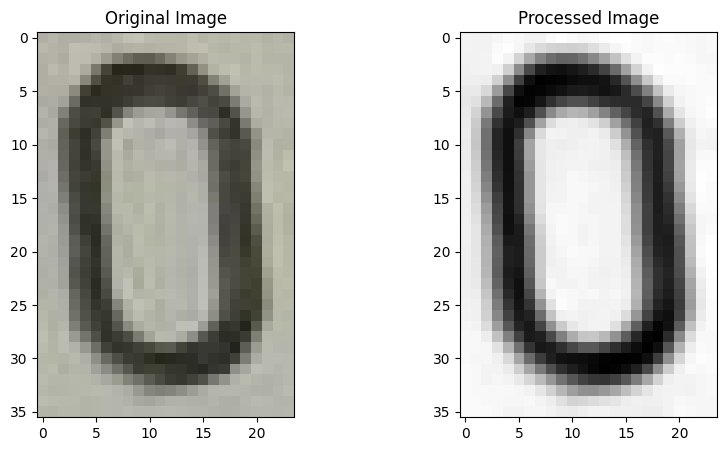

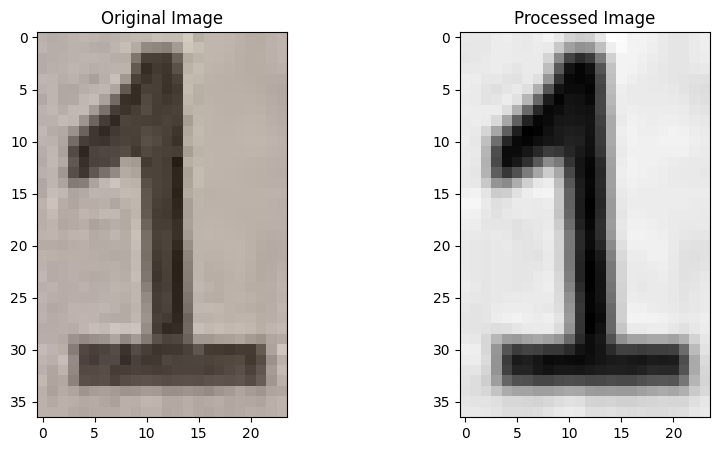

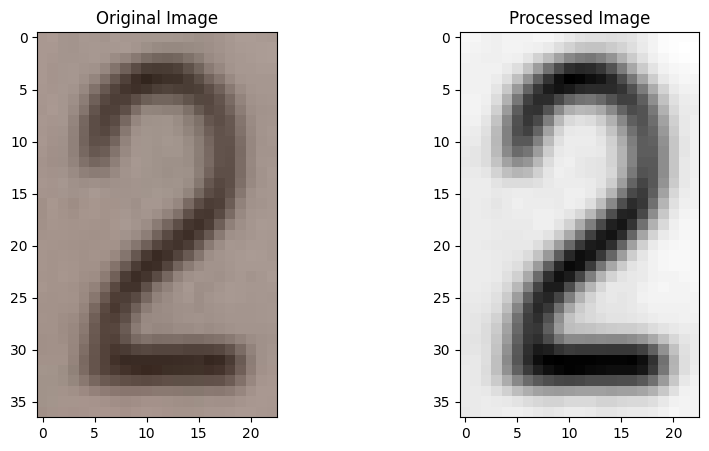

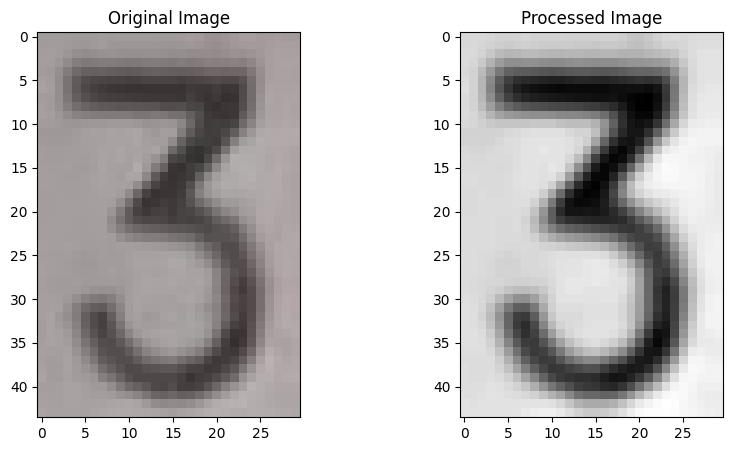

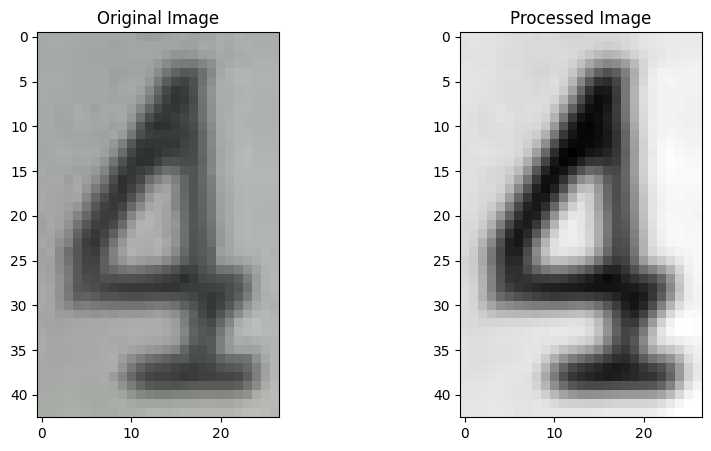

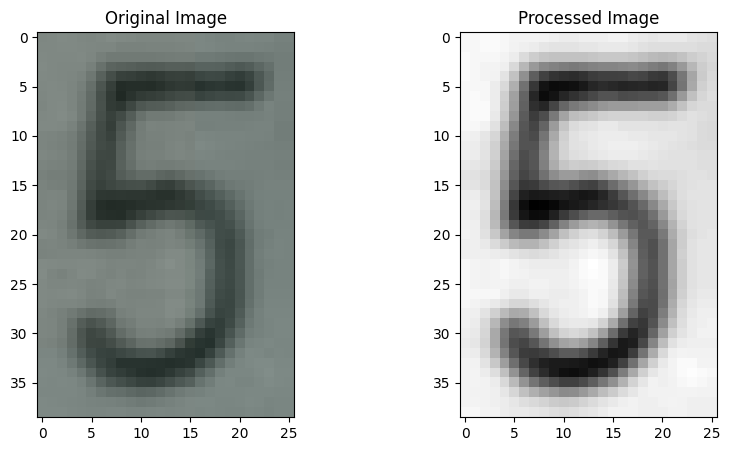

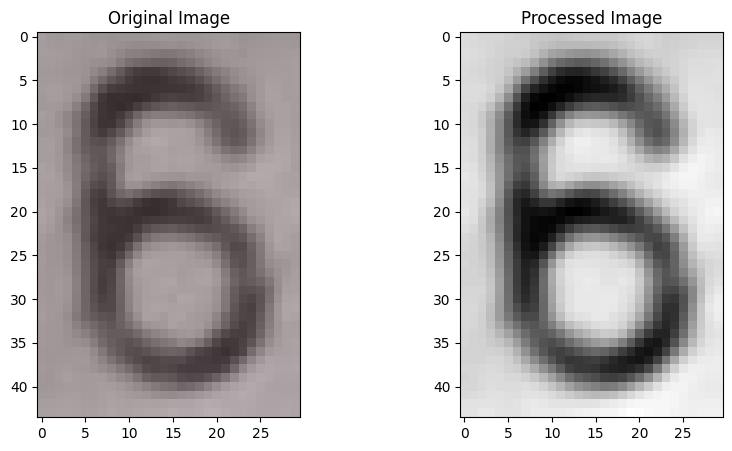

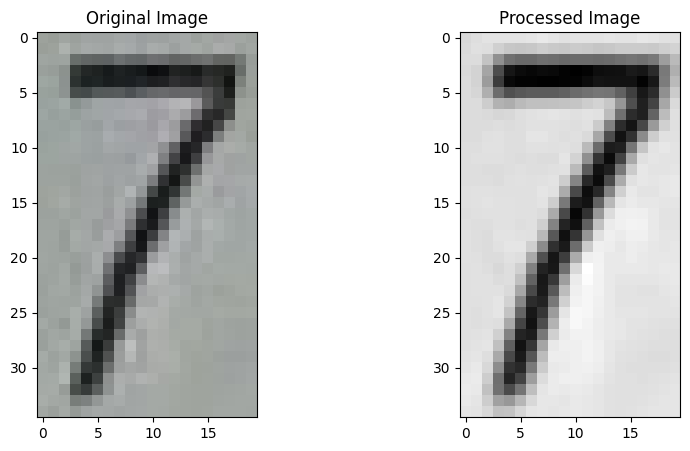

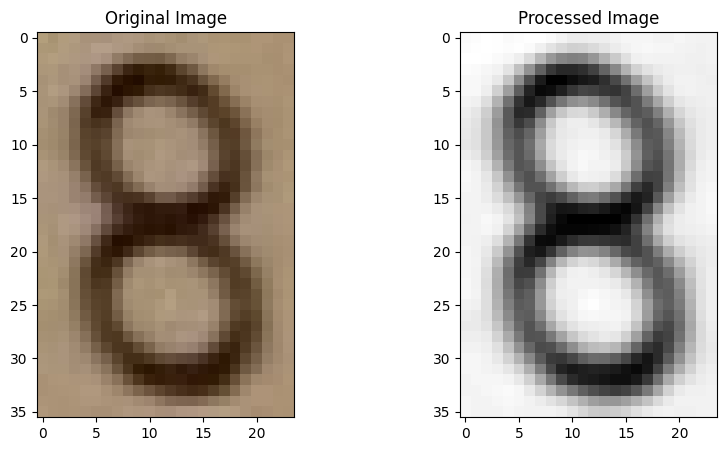

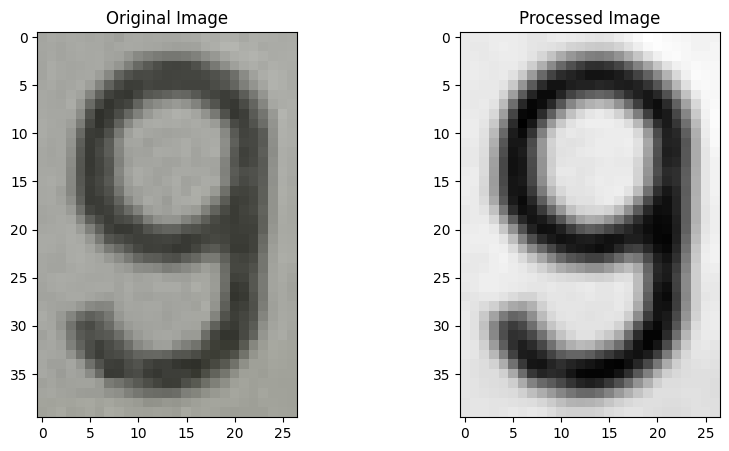

In [94]:

# Step 1: Load all digit templates
templates = []
for i in range(10):
    template = cv2.imread(f'D:\\ComputerVision\\Assignment4\\DigitTemplates\\digit{i}.jpg')
    template_processed = preprocess_template(template) 
    templates.append(template_processed)
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(template, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct colors
    plt.title("Original Image")
    plt.subplot(1, 2, 2)
    plt.imshow(template_processed, cmap='gray')  # Processed image (grayscale)
    plt.title("Processed Image")
    plt.show()


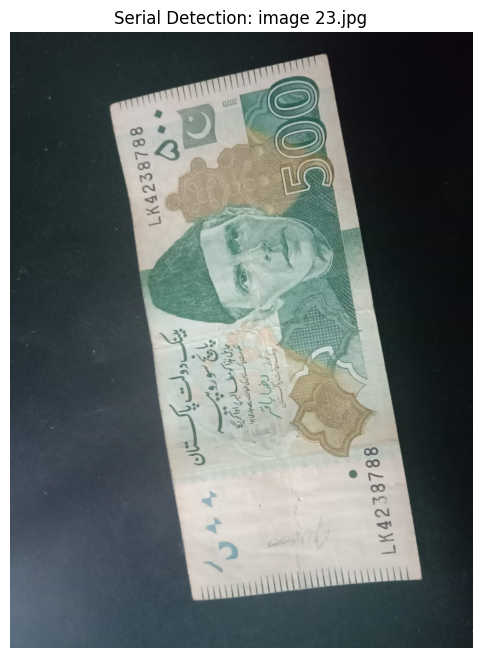

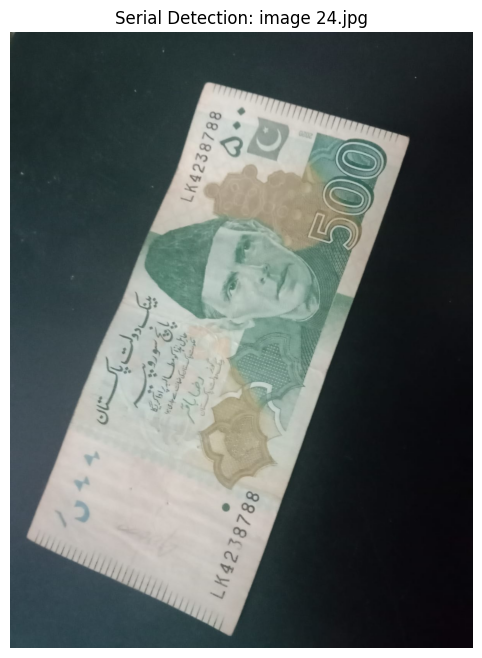

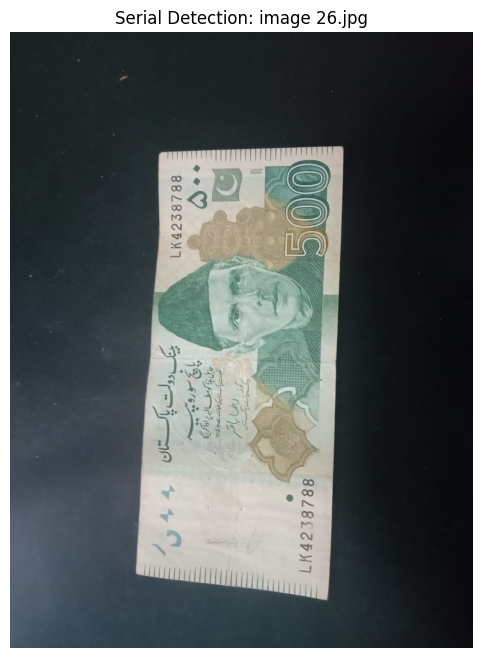

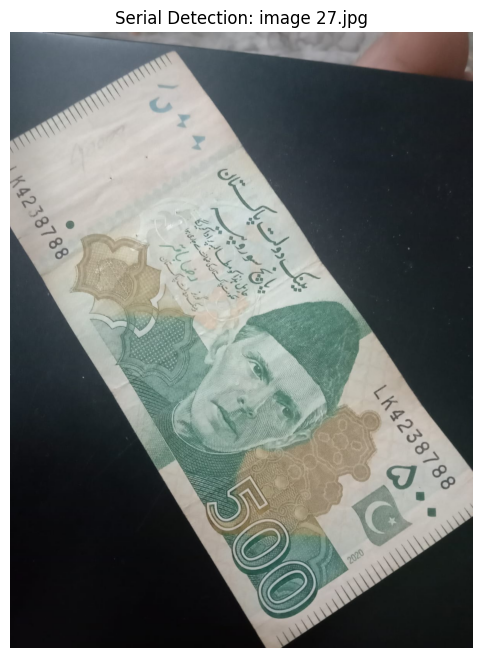

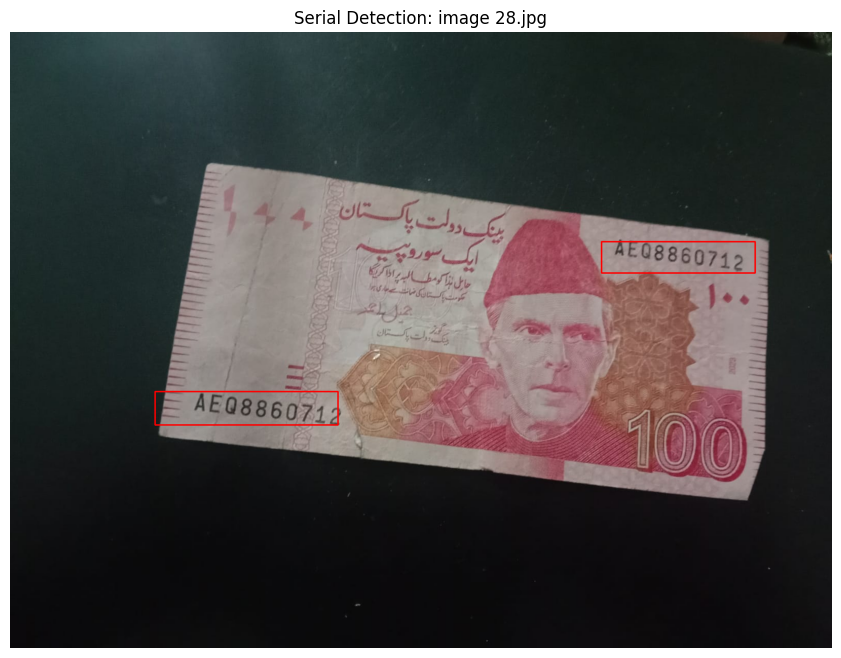

...

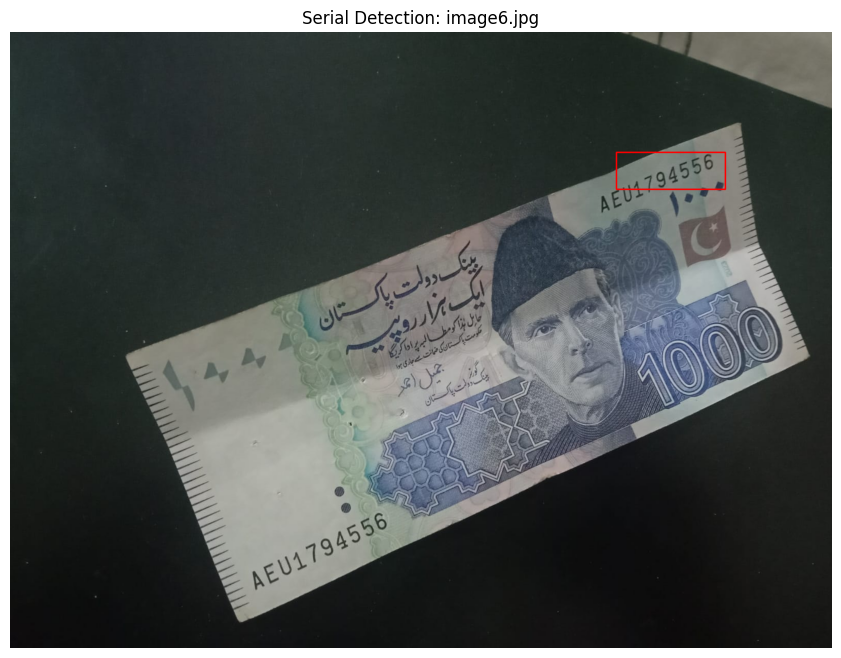

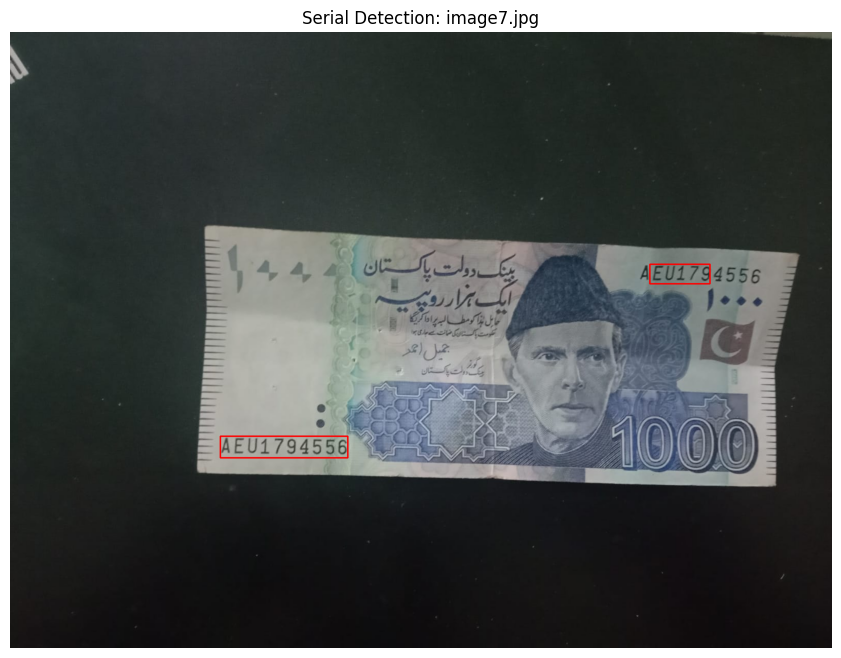

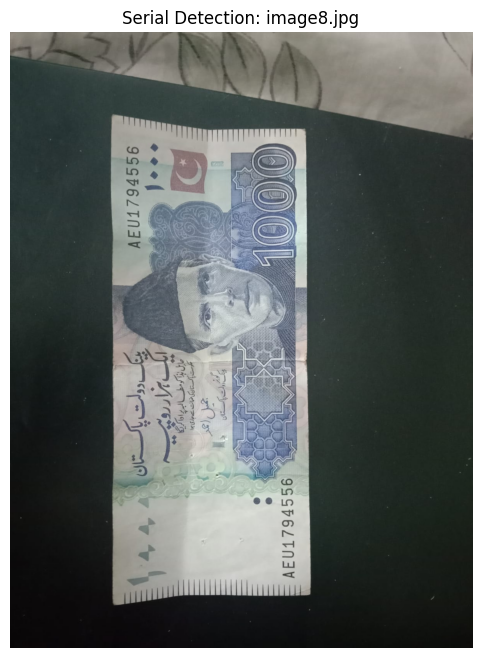

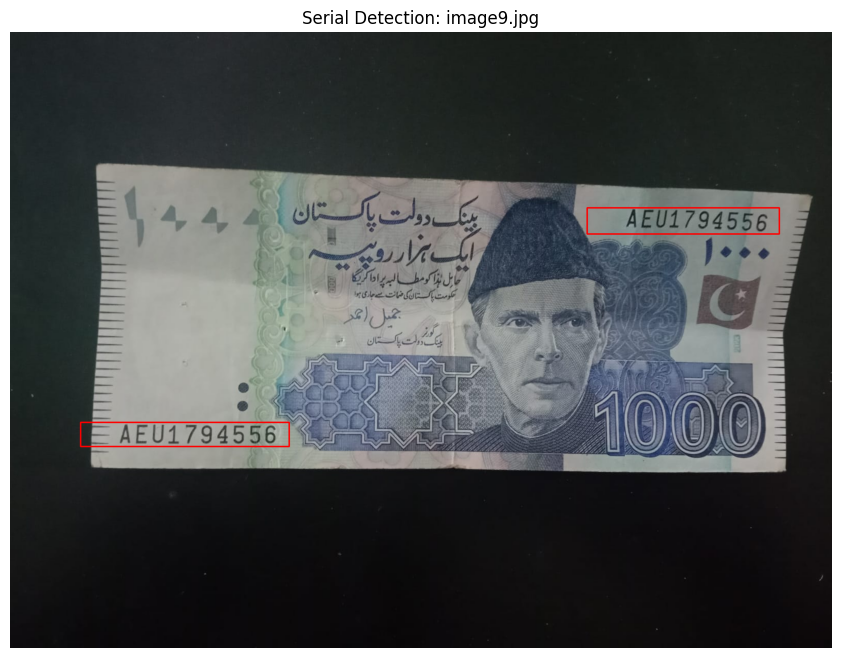

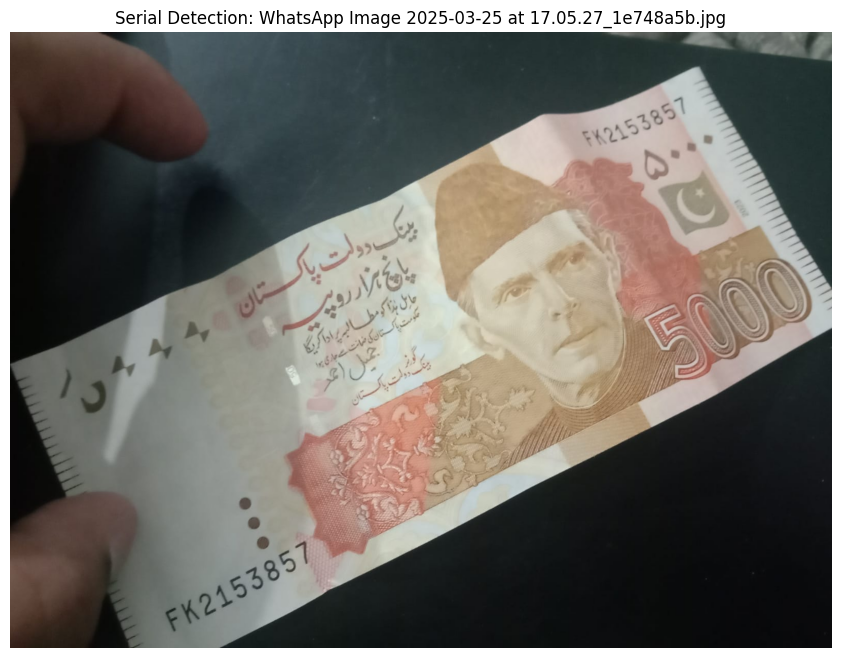

In [95]:
output_dir = r'D:\ComputerVision\Assignment4\Results'  # Use raw string for Windows paths
os.makedirs(output_dir, exist_ok=True)

# CSV file path
csv_path = os.path.join(output_dir, 'coordinates.csv')

# Correct Step 2: Read and prepare note image
folder_path = r'D:\ComputerVision\Assignment4\currency note data set\dataSet'


with open(csv_path, 'w', newline='') as csvfile:
    csv_writer = csv.writer(csvfile)
    # Write header
    csv_writer.writerow(['image_name', 'x1', 'y1', 'x2', 'y2'])
    
    # Loop through all image files in the input folder
    for filename in os.listdir(folder_path):
        
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
           
            file_path = os.path.join(folder_path, filename)  # Construct the full file path
            
            note_img = cv2.imread(file_path)  # Read the image
            
            # Check if the image was loaded successfully
            if note_img is not None:                     
                
                note_processed = preprocess_image(note_img)
                
                digit_boxes = []
            
                # Template matching for each digit
                for template in templates:
                    h, w = template.shape
                    res = cv2.matchTemplate(note_processed, template, cv2.TM_CCOEFF_NORMED)
                    loc = np.where(res >= 0.73)  # Higher threshold for digits
                    
                    for pt in zip(*loc[::-1]):
                        digit_boxes.append((pt[0], pt[1], pt[0]+w, pt[1]+h))
                
                serial_boxes = strict_horizontal_merge(digit_boxes)  # Single rectangle covering all digits
                serial_blocks= merge_overlapping_boxes(serial_boxes, overlap_threshold=0.1)  # Stricter merging red rectngles
                
                # Draw results (red for merged serial blocks)
                result_img = note_img.copy()
                
                #for box in digit_boxes:
                 #   cv2.rectangle(result_img, (box[0], box[1]), (box[2], box[3]), (0, 255, 0), 1)
                
                for i, block in enumerate(serial_blocks):
                    # Expand coordinates
                    expanded_x1 = max(0, block[0] - 5)
                    expanded_x2 = block[2] + 20
                    
                    # Draw rectangle
                    cv2.rectangle(result_img, (expanded_x1, block[1]), 
                                 (expanded_x2, block[3]), (0, 0, 255), 2)
                    
                    # Save coordinates to CSV
                    csv_writer.writerow([
                        filename,          # image name
                        expanded_x1,      # x1
                        block[1],         # y1 
                        expanded_x2,      # x2
                        block[3]          # y2
                    ])
                    
                output_img_path = os.path.join(output_dir, f'annotated_{filename}')
                cv2.imwrite(output_img_path, result_img)
                
                # Display in notebook 
                plt.figure(figsize=(12, 8))
                result_rgb = cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB)
                plt.imshow(result_rgb)
                plt.title(f"Serial Detection: {filename}")
                plt.axis('off')  
                plt.show()